In [3]:
import glob
import pandas as pd
import mne
import matplotlib
import matplotlib.pyplot as plt
from io import StringIO
import mne
from mne.io import read_raw_eeglab, read_epochs_eeglab
import numpy as np
from scipy import signal
from scipy import fftpack
import seaborn as sns
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from tqdm import tqdm, tqdm_notebook
import math

import multiprocessing
from tpot import TPOTRegressor
from oct2py import octave

from joblib import Parallel, delayed
import multiprocessing
from joblib import wrap_non_picklable_objects
import json
import pickle
import os.path
from mpl_toolkits.mplot3d import axes3d
import timeit
from skimage.transform import resize
from timeit import default_timer as timer
from datetime import timedelta
import json


import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.genmod import bayes_mixed_glm as glm

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.feature_selection import RFECV

from spectrum import arburg, arma2psd, pburg
import pylab
from scipy.signal import find_peaks
from scipy.integrate import simps
from scipy.io import loadmat

/home/raquib/anaconda3/envs/tmseeg/lib/python3.7/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.scorer module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)
/home/raquib/anaconda3/envs/tmseeg/lib/python3.7/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.feature_selection.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.feature_selection. Anything that cannot be imported from sklearn.feature_selection is now part of the private API.
  warnings.warn(message, FutureWarning)


# V1

This is the code for doing that

(2863, 28)


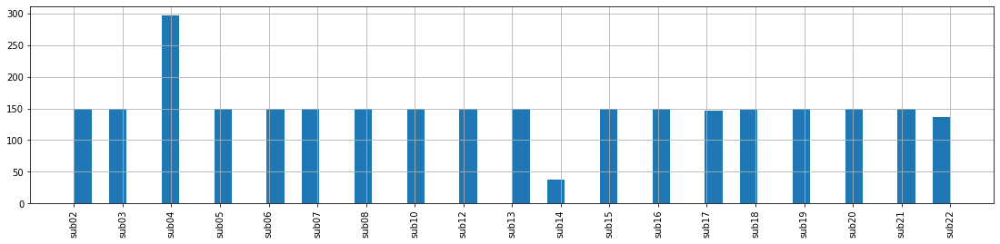

In [4]:
df = pd.read_excel('139-new-ld-v3.xlsx')
df['sub'].hist(figsize=(19,4), xrot=90, bins=50, align='mid')
print(df.shape)

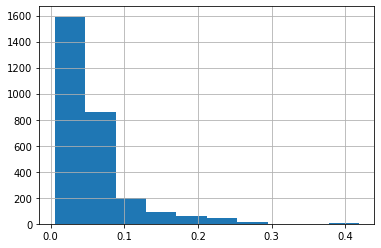

In [5]:
df['mep_duration'].hist()

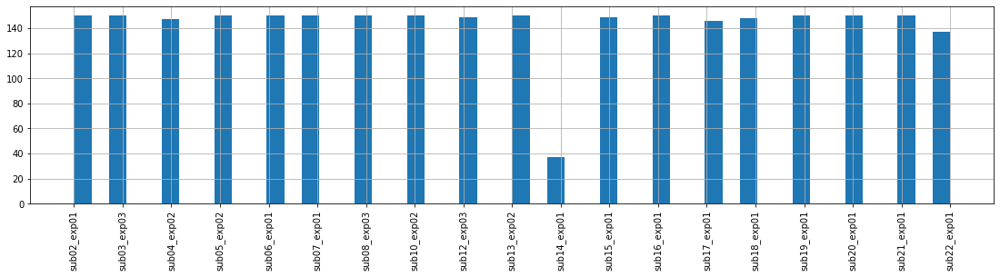

In [6]:
# df = df[~df['sub'].isin(['sub05', 'sub09', 'sub11', 'sub10'])]
# df = df[~df['sub'].isin(['sub05', 'sub09', 'sub11', 'sub10', 'sub03', 'sub06', 'sub12'])]
df['sub_exp'] = df['sub'] + "_" + df['exp']
df['sub_exp_run'] = df['sub_exp'] + "_" + df['run']
df = df[~df['sub_exp'].isin(['sub04_exp01'])]
# df = df[~df['sub_exp'].isin(['sub03_exp01'])]
# df = df[df['mep_latency'] < 0.2]
# df = df[df['mep_latency'] > 0]
df.to_excel('140-ld-v3.xlsx')
df['sub_exp'].hist(figsize=(19,4), xrot=90, bins=50, align='mid')

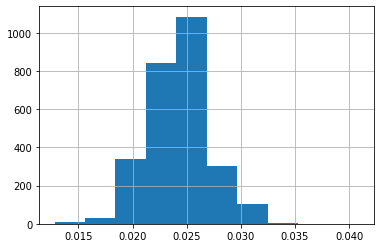

In [7]:
df['mep_latency'].hist()

# V2

In [8]:
df['theta_power_log'] = np.log(df['theta_power'])
df['mu_power_log'] = np.log(df['mu_power'])
df['beta_power_log'] = np.log(df['beta_power'])
df['gamma_power_log'] = np.log(df['gamma_power'])
df['mep_size_log'] = np.log(df['mep_size'])
df['mep_duration_log'] = np.log(df['mep_duration'])
df['mep_area_log'] = np.log(df['mep_area'])
df.shape

(2713, 37)

In [9]:
def plot_interaction(y_var, y_label):
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(22,5))
    sns.regplot(x='theta_power_log', y=y_var, data=df[(df['theta_phase'] >= 45) & (df['theta_phase'] <= 135)], ax=ax1, marker='.')
    sns.regplot(x='theta_power_log', y=y_var, data=df[(df['theta_phase'] >= 225) & (df['theta_phase'] <= 315)], ax=ax1, marker='.')
    ax1.set_xlabel('Theta Power')
    ax1.set_ylabel(y_label)
    
    sns.regplot(x='mu_power_log', y=y_var, data=df[(df['mu_phase'] >= 45) & (df['mu_phase'] <= 135)], ax=ax2, marker='.')
    sns.regplot(x='mu_power_log', y=y_var, data=df[(df['mu_phase'] >= 225) & (df['mu_phase'] <= 315)], ax=ax2, marker='.')
    ax2.set_xlabel('Mu Power')
    ax2.set_ylabel(y_label)
    
    sns.regplot(x='beta_power_log', y=y_var, data=df[(df['beta_phase'] >= 45) & (df['beta_phase'] <= 135)], ax=ax3, marker='.')
    sns.regplot(x='beta_power_log', y=y_var, data=df[(df['beta_phase'] >= 225) & (df['beta_phase'] <= 315)], ax=ax3, marker='.')
    ax3.set_xlabel('Beta Power')
    ax3.set_ylabel(y_label)
    
    sns.regplot(x='gamma_power_log', y=y_var, data=df[(df['gamma_phase'] >= 45) & (df['gamma_phase'] <= 135)], ax=ax4, marker='.')
    sns.regplot(x='gamma_power_log', y=y_var, data=df[(df['gamma_phase'] >= 225) & (df['gamma_phase'] <= 315)], ax=ax4, marker='.')
    ax4.set_xlabel('Gamma Power')
    ax4.set_ylabel(y_label)
    
def plot_all_bands(y_var, y_label):
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(22,5))
    for sub in df['sub'].unique():
        x = df[df['sub'] == sub]
        sns.regplot(x='theta_power_log', y=y_var, data=x, ax=ax1, marker='.')
    ax1.set_xlabel('Theta Power')
    ax1.set_ylabel(y_label)
    
    for sub in df['sub'].unique():
        x = df[df['sub'] == sub]
        sns.regplot(x='mu_power_log', y=y_var, data=x, ax=ax2, marker='.')
    ax2.set_xlabel('Mu Power')
    ax2.set_ylabel(y_label)
    
    for sub in df['sub'].unique():
        x = df[df['sub'] == sub]
        sns.regplot(x='beta_power_log', y=y_var, data=x, ax=ax3, marker='.')
    ax3.set_xlabel('Beta Power')
    ax3.set_ylabel(y_label)
    
    for sub in df['sub'].unique():
        x = df[df['sub'] == sub]
        sns.regplot(x='gamma_power_log', y=y_var, data=x, ax=ax4, marker='.')
    ax4.set_xlabel('Gamma Power')
    ax4.set_ylabel(y_label)
    
def plot_reg(y_var, y_label):
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(22,5))
    sns.regplot(x='theta_power_log', y=y_var, data=df, ax=ax1, marker='.')
    ax1.set_xlabel('Theta Power')
    ax1.set_ylabel(y_label)
    
    sns.regplot(x='mu_power_log', y=y_var, data=df, ax=ax2, marker='.')
    ax2.set_xlabel('Mu Power')
    ax2.set_ylabel(y_label)
    
    sns.regplot(x='beta_power_log', y=y_var, data=df, ax=ax3, marker='.')
    ax3.set_xlabel('Beta Power')
    ax3.set_ylabel(y_label)
    
    sns.regplot(x='gamma_power_log', y=y_var, data=df, ax=ax4, marker='.')
    ax4.set_xlabel('Gamma Power')
    ax4.set_ylabel(y_label)
    
def plot_mean(y_var, y_label):
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(22,5))
    sns.lineplot(x='theta_power_log', y=y_var, data=df, ax=ax1)
    ax1.set_xlabel('Theta Power')
    ax1.set_ylabel(y_label)
    
    sns.lineplot(x='mu_power_log', y=y_var, data=df, ax=ax2)
    ax2.set_xlabel('Mu Power')
    ax2.set_ylabel(y_label)
    
    sns.lineplot(x='beta_power_log', y=y_var, data=df, ax=ax3)
    ax3.set_xlabel('Beta Power')
    ax3.set_ylabel(y_label)
    
    sns.lineplot(x='gamma_power_log', y=y_var, data=df, ax=ax4)
    ax4.set_xlabel('Gamma Power')
    ax4.set_ylabel(y_label)
    
def plot_phase(band):
    with plt.style.context(['science-raquib']):
        fig, axs = plt.subplots(2, 2, figsize=(5, 5))
        axs[0, 0].plot(df[band+'_phase'] * 0.0174533 - 3.1416, df['mep_size_log'], '.')
        axs[0, 0].set_xlabel(band.title() + ' phase')
        axs[0, 0].set_ylabel('MEP Size (log)')

        axs[0, 1].plot(df[band+'_phase'] * 0.0174533 - 3.1416, df['mep_latency'], '.')
        axs[0, 1].set_xlabel(band.title() + ' phase')
        axs[0, 1].set_ylabel('MEP Latency')

        axs[1, 0].plot(df[band+'_phase'] * 0.0174533 - 3.1416, df['mep_duration_log'], '.')
        axs[1, 0].set_xlabel(band.title() + ' phase')
        axs[1, 0].set_ylabel('MEP Duration (log)')

        axs[1, 1].plot(df[band+'_phase'] * 0.0174533 - 3.1416, df['mep_area_log'], '.')
        axs[1, 1].set_xlabel(band.title() + ' phase')
        axs[1, 1].set_ylabel('MEP Area (log)')

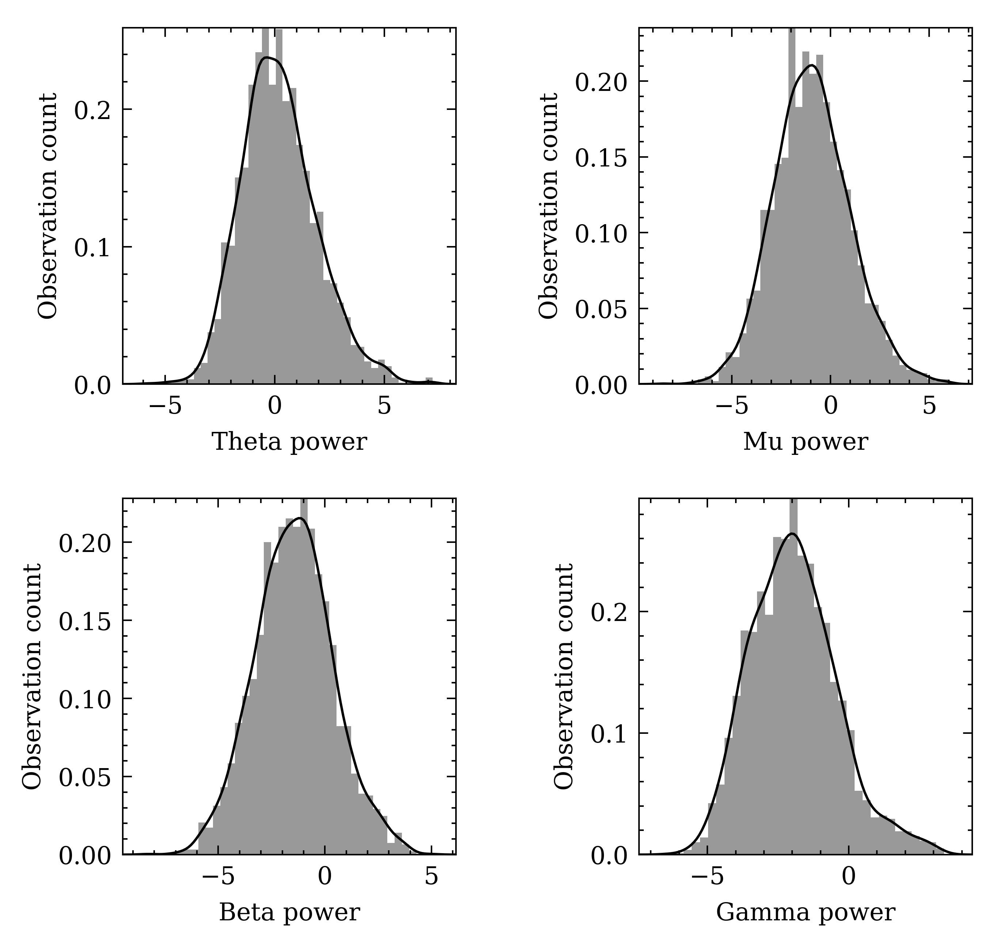

In [52]:
def plot_hist(ax, band, param='power'):
    sns.distplot(df[band + '_' + param + '_log'], ax=ax)
    ax.set_xlabel(band.title() + ' ' + param)
    ax.set_ylabel('Observation count')
    
with plt.style.context(['science-raquib']):
    fig, axs = plt.subplots(2, 2, figsize=(5, 5))
    plot_hist(axs[0, 0], 'theta')
    plot_hist(axs[0, 1], 'mu')
    plot_hist(axs[1, 0], 'beta')
    plot_hist(axs[1, 1], 'gamma')
    fig.subplots_adjust(hspace=.32, wspace=0.55)

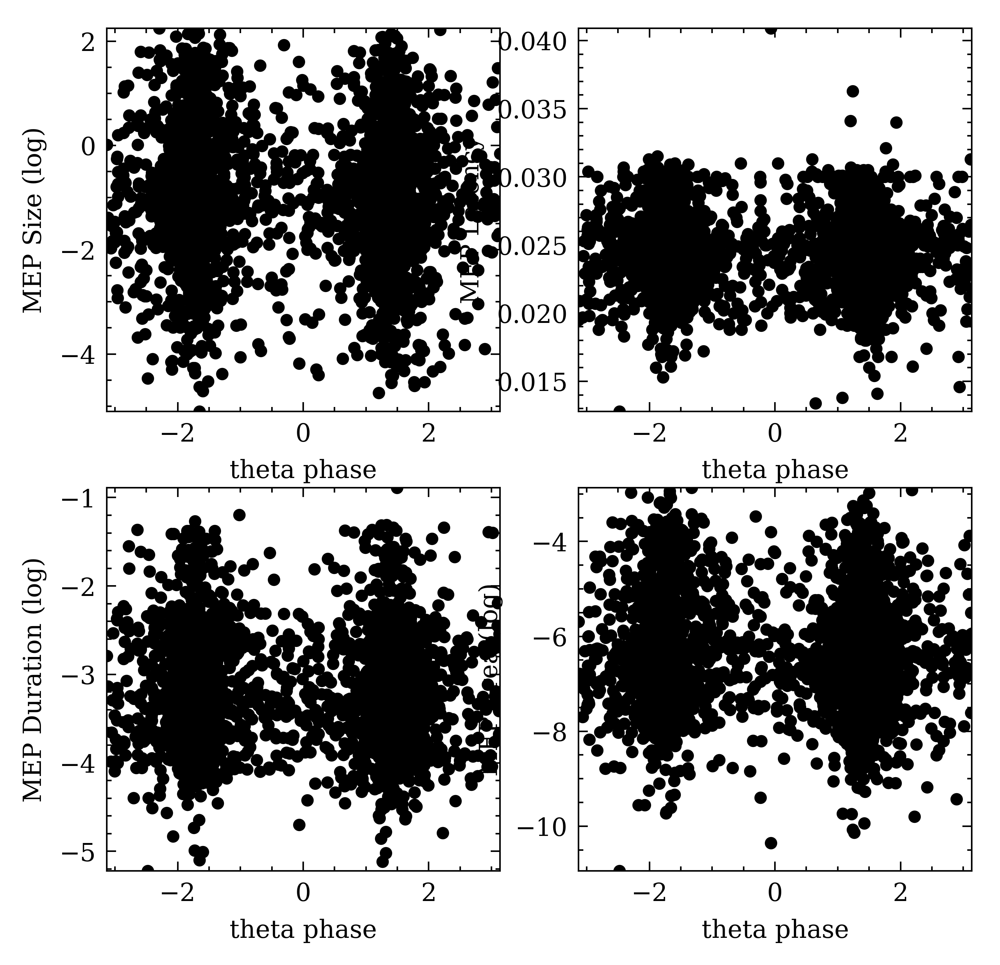

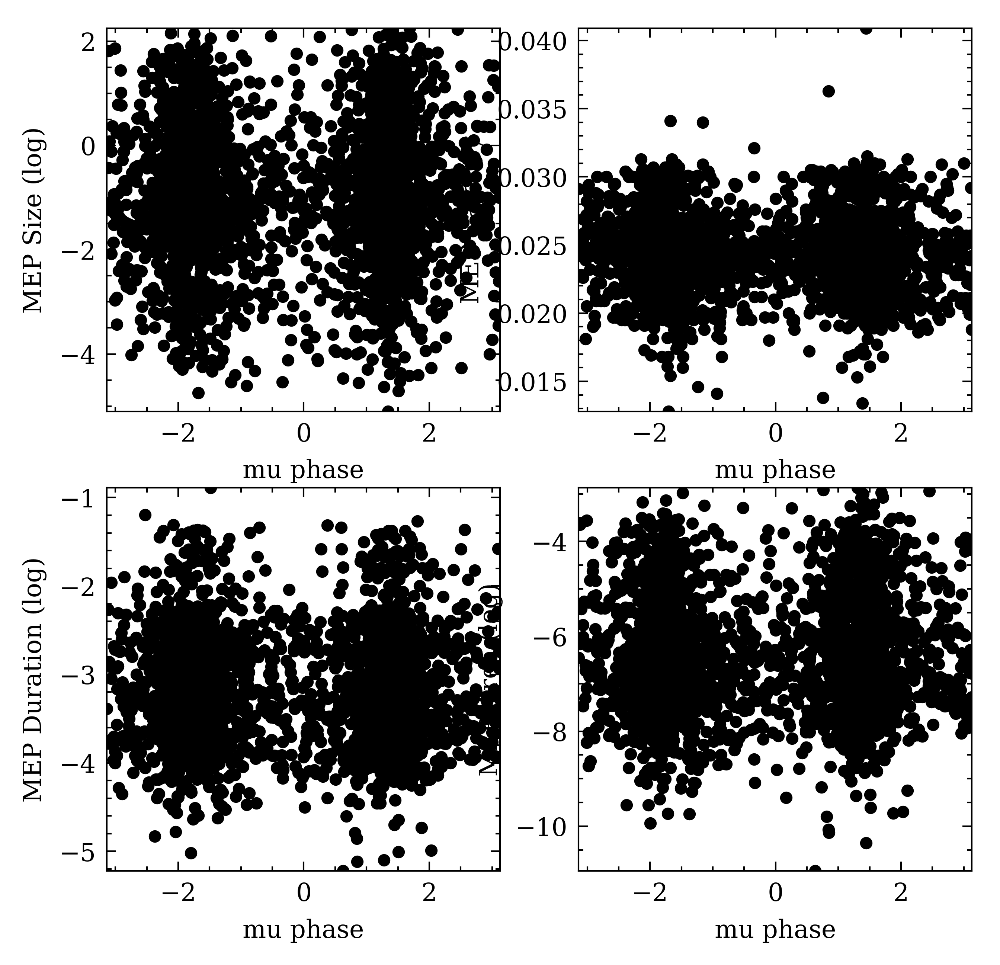

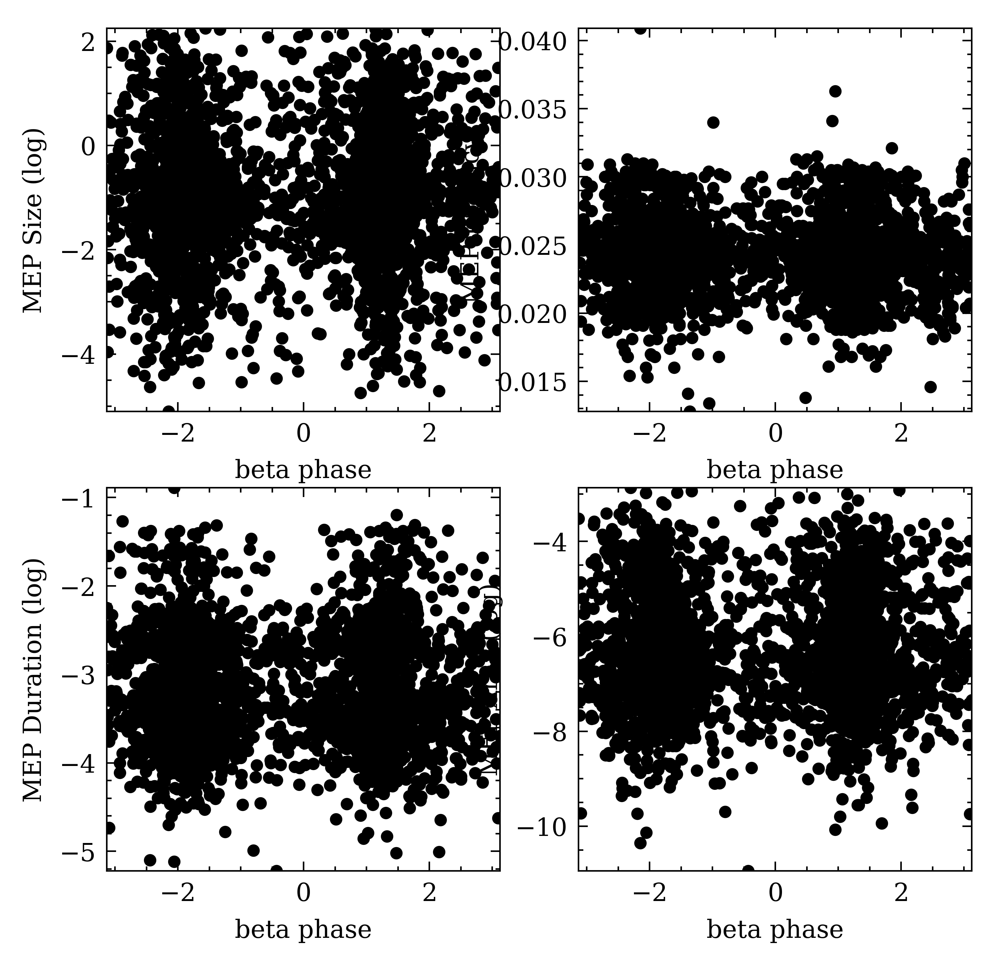

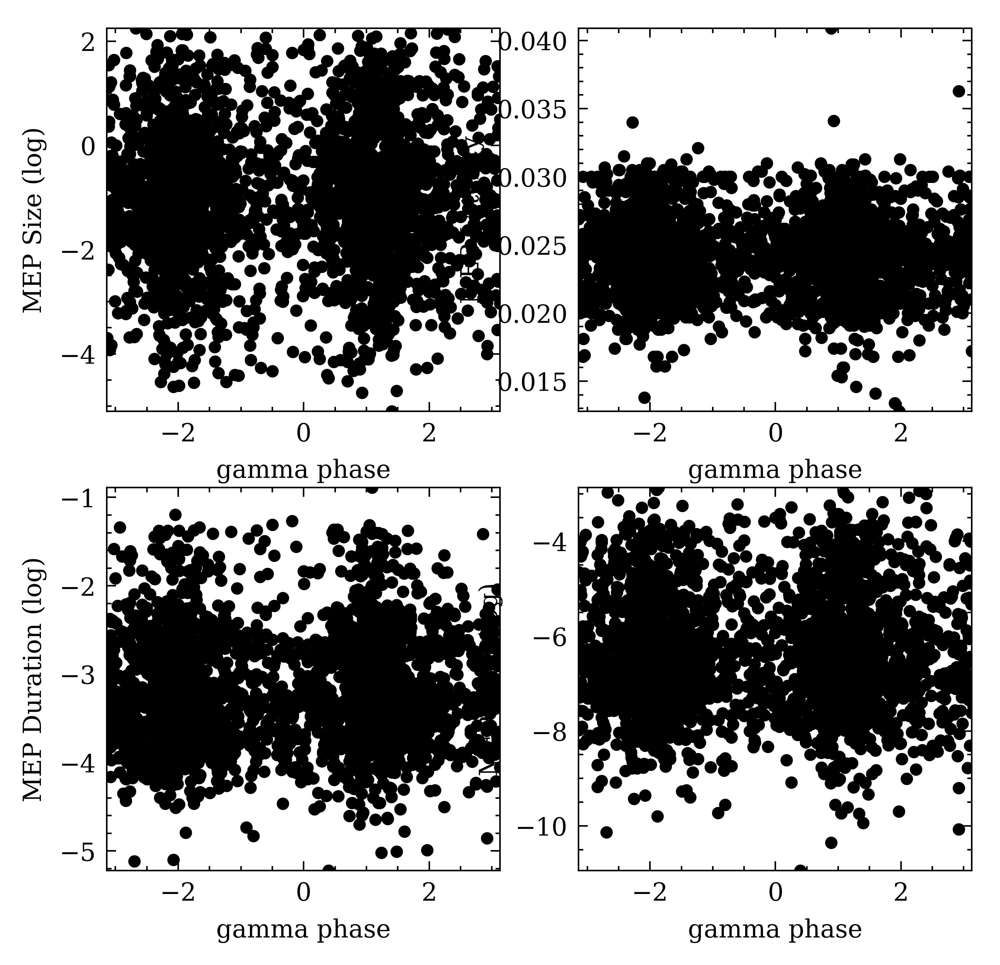

In [51]:
plot_phase('theta')
plot_phase('mu')
plot_phase('beta')
plot_phase('gamma')

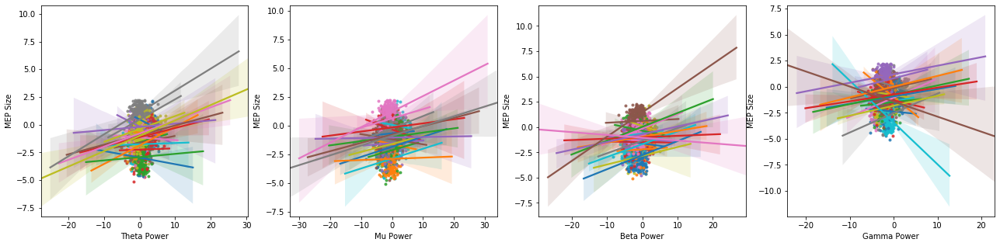

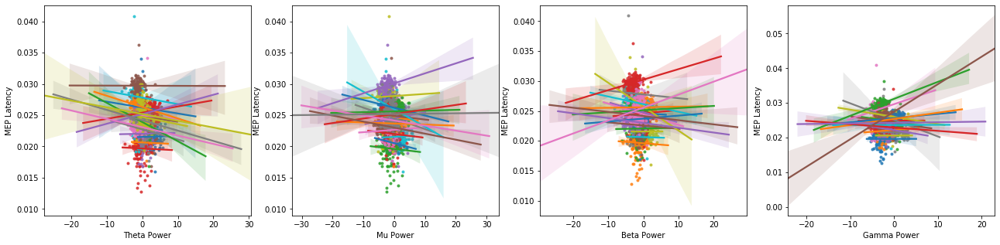

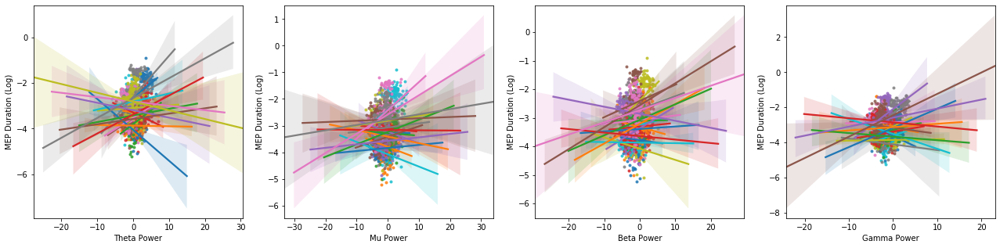

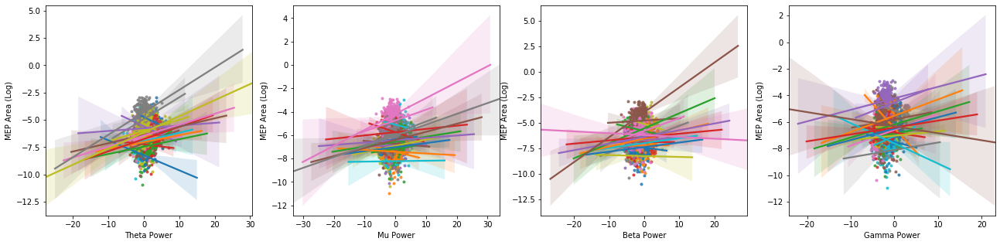

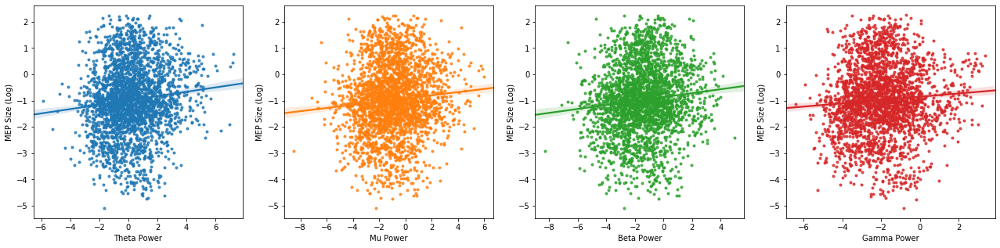

...

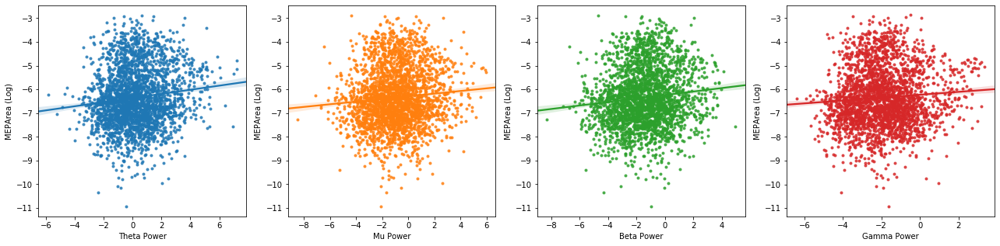

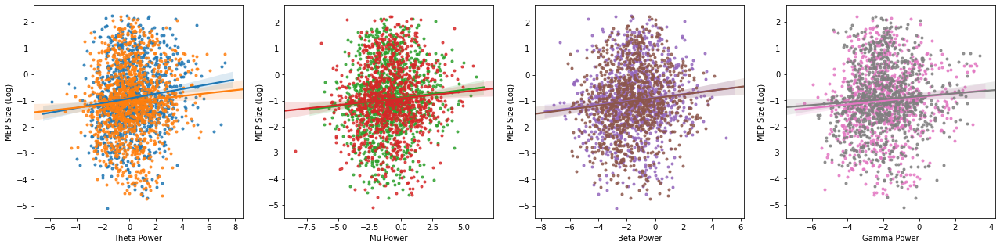

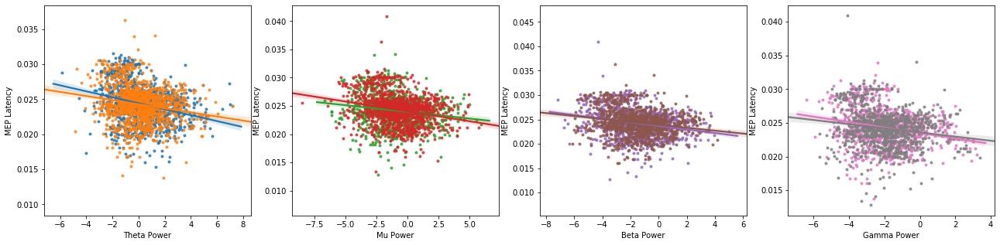

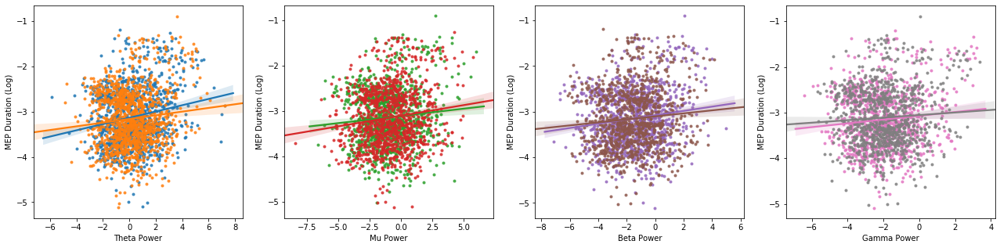

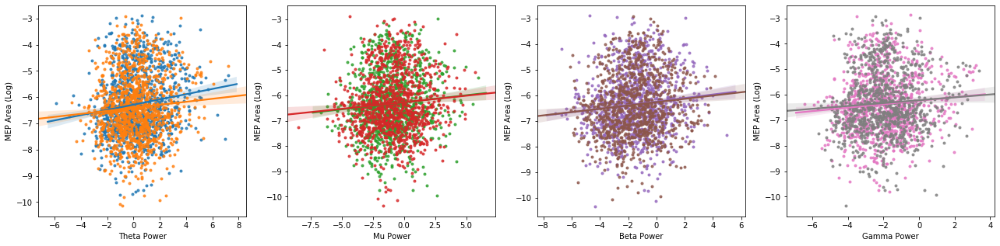

In [44]:
plot_all_bands('mep_size_log', 'MEP Size')
plot_all_bands('mep_latency', 'MEP Latency')
plot_all_bands('mep_duration_log', 'MEP Duration (Log)')
plot_all_bands('mep_area_log', 'MEP Area (Log)')

plot_reg('mep_size_log', 'MEP Size (Log)')
plot_reg('mep_latency', 'MEP Latency')
plot_reg('mep_duration_log', 'MEP Duration (Log)')
plot_reg('mep_area_log', 'MEPArea (Log)')

plot_interaction('mep_size_log', 'MEP Size (Log)')
plot_interaction('mep_latency', 'MEP Latency')
plot_interaction('mep_duration_log', 'MEP Duration (Log)')
plot_interaction('mep_area_log', 'MEP Area (Log)')

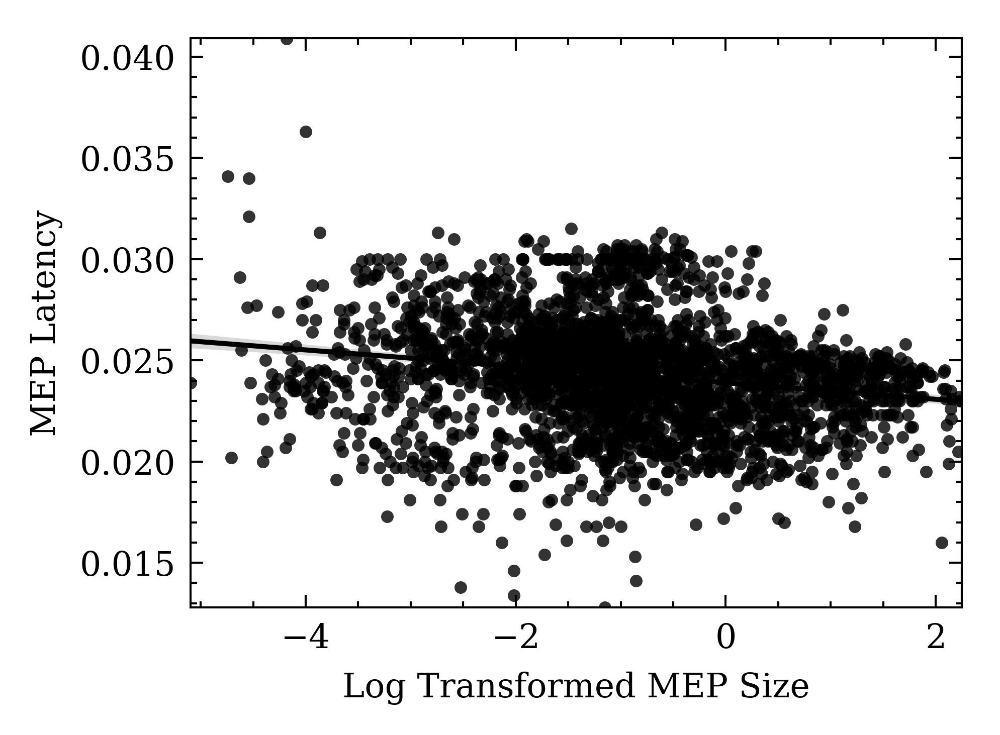

In [114]:
# plt.plot(np.log(df['mep_size']), df['mep_latency'], '.')
with plt.style.context(['science-raquib']):
    sns.regplot(x='mep_size_log', y='mep_latency', data=df, marker='.', scatter_kws={"linewidths": 0.001})
    plt.xlabel('Log Transformed MEP Size')
    plt.ylabel('MEP Latency')

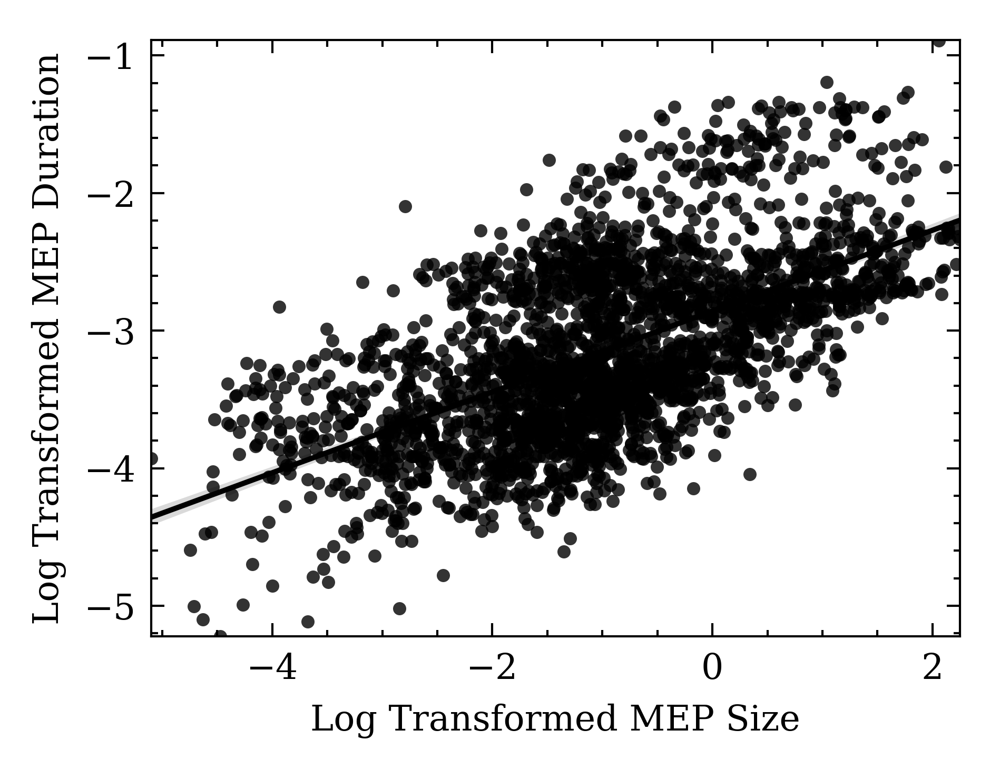

In [115]:
with plt.style.context(['science-raquib']):
    sns.regplot(x='mep_size_log', y='mep_duration_log', data=df, marker='.', scatter_kws={"linewidths": 0.001})
    plt.xlabel('Log Transformed MEP Size')
    plt.ylabel('Log Transformed MEP Duration')

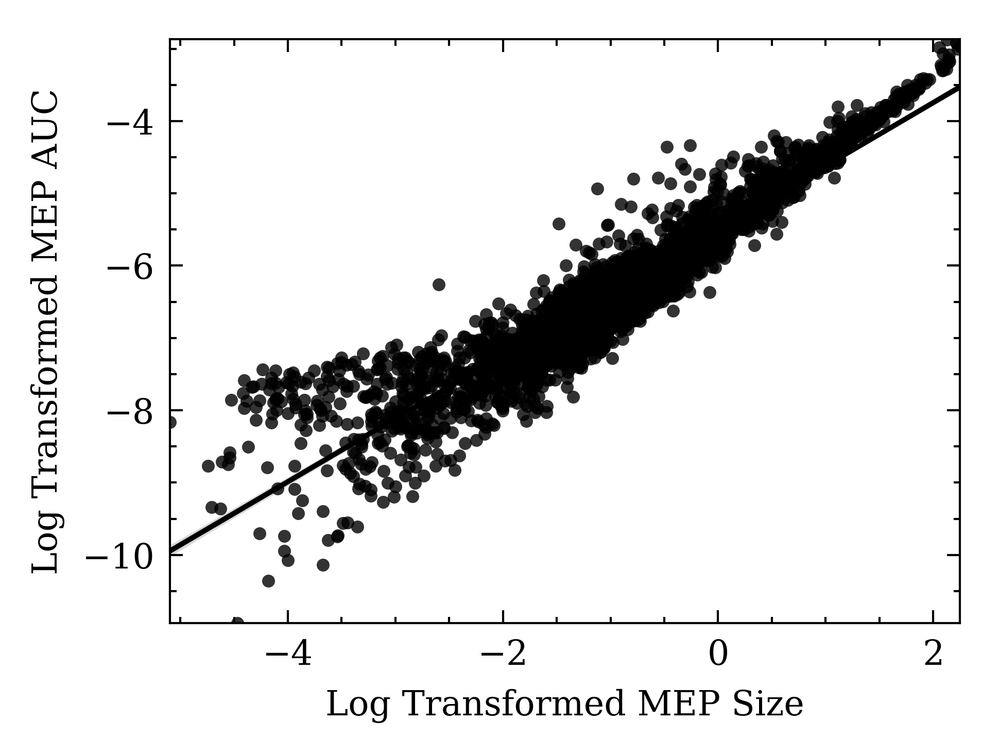

In [116]:
with plt.style.context(['science-raquib']):
    sns.regplot(x='mep_size_log', y='mep_area_log', data=df, marker='.', scatter_kws={"linewidths": 0.001})
    plt.xlabel('Log Transformed MEP Size')
    plt.ylabel('Log Transformed MEP AUC')

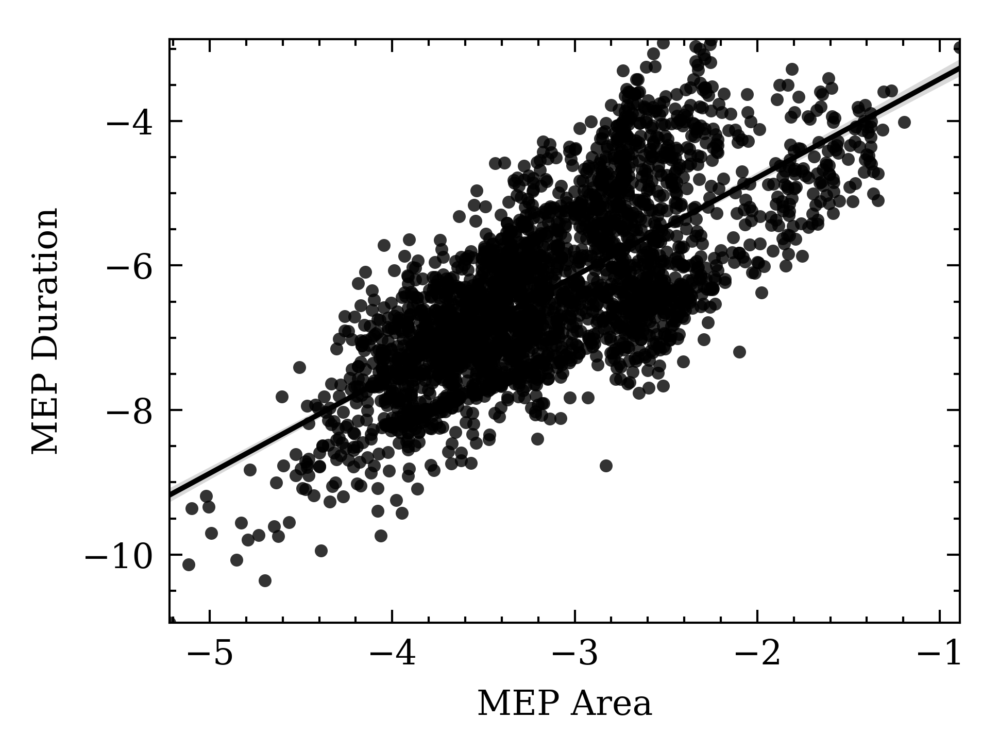

In [22]:
with plt.style.context(['science-raquib']):
    sns.regplot(x='mep_duration_log', y='mep_area_log', data=df, marker='.', scatter_kws={"linewidths": 0.001})
    plt.xlabel('MEP Area')
    plt.ylabel('MEP Duration')

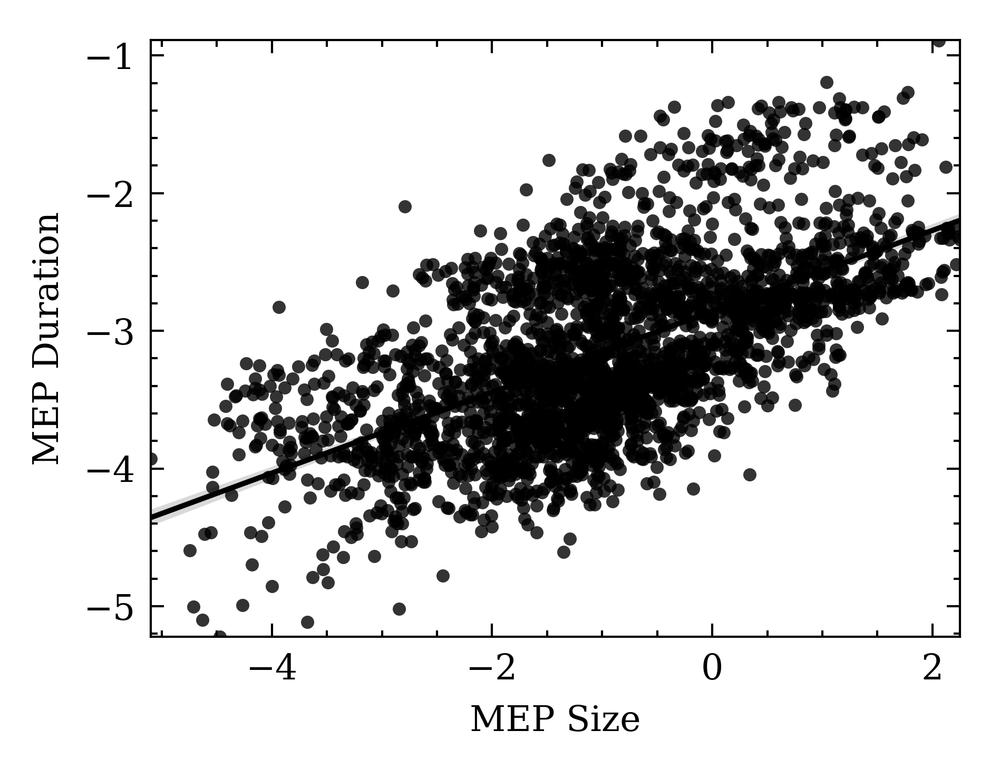

In [23]:
with plt.style.context(['science-raquib']):
    sns.regplot(x='mep_size_log', y='mep_duration_log', data=df, marker='.', scatter_kws={"linewidths": 0.001})
    plt.xlabel('MEP Size')
    plt.ylabel('MEP Duration')

In [6]:
df.to_excel('140-ld-v2.xlsx')

In [7]:
df['sub'].unique().shape

(19,)

# Figures for paper

In [10]:
df_long = pd.melt(df, value_vars=['theta_power_log', 'mu_power_log', 'beta_power_log', 'gamma_power_log'], var_name='Band', value_name='power')
df_long['Band'] = df_long['Band'].replace({'theta_power_log': 'Theta', 'mu_power_log': 'Mu', 'beta_power_log': 'Beta', 'gamma_power_log': 'Gamma'})
df_long.head()

,Band,power
0,Theta,6.011299
1,Theta,5.463617
2,Theta,5.135463
3,Theta,4.771527
4,Theta,3.960605


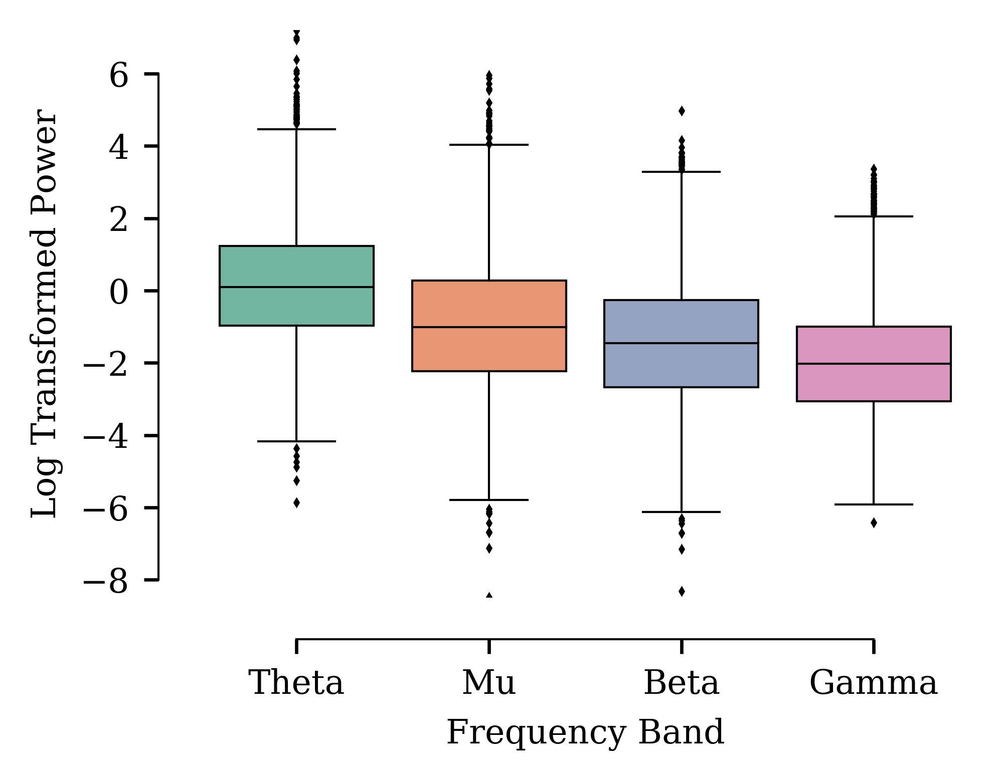

In [7]:
with plt.style.context(['science-raquib-axis']):
    fig, ax = plt.subplots()
    sns.boxplot(x="Band", y="power", data=df_long, palette='Set2', linewidth=0.5, fliersize=0.5, color="10", ax=ax)
    sns.despine(offset=10, trim=True)
    plt.xlabel('Frequency Band')
    plt.ylabel('Log Transformed Power')
for i, artist in enumerate(ax.artists):
    # col = artist.get_facecolor()
    artist.set_edgecolor('black')
    for j in range(i*6,i*6+6):
        line = ax.lines[j]
        line.set_color('black')
        line.set_mfc('black')
        line.set_mec('black')
    # print(artist.get_facecolor())

In [11]:
df_long = df
subs = df_long.sort_values(by='sub')['sub'].unique()

sub_keys = dict()
i = 1
for sub in subs:
    sub_keys[sub] = 'S' + str(i)
    i = i+1
sub_keys

{'sub02': 'S1',
 'sub03': 'S2',
 'sub04': 'S3',
 'sub05': 'S4',
 'sub06': 'S5',
 'sub07': 'S6',
 'sub08': 'S7',
 'sub10': 'S8',
 'sub12': 'S9',
 'sub13': 'S10',
 'sub14': 'S11',
 'sub15': 'S12',
 'sub16': 'S13',
 'sub17': 'S14',
 'sub18': 'S15',
 'sub19': 'S16',
 'sub20': 'S17',
 'sub21': 'S18',
 'sub22': 'S19'}

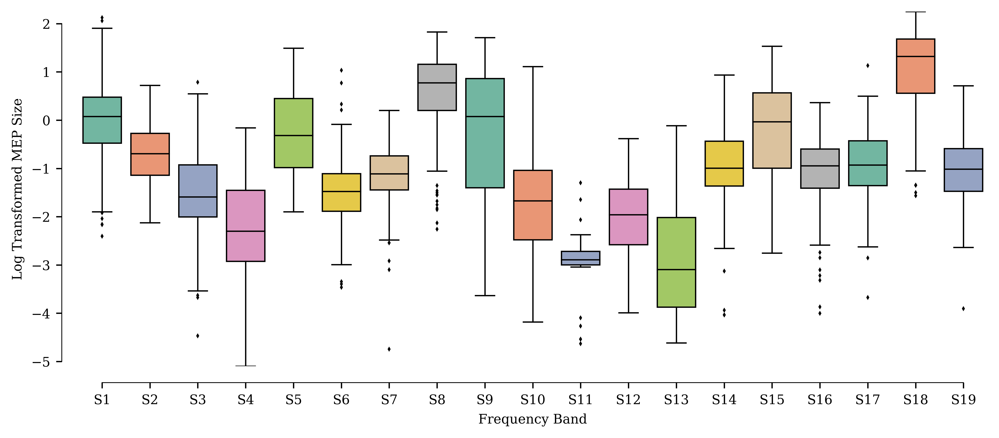

In [12]:

df_long['sub2'] = df_long['sub'].replace(sub_keys)

with plt.style.context(['science-raquib-axis']):
    fig, ax = plt.subplots(figsize=(10,4))
    sns.boxplot(x="sub2", y="mep_size_log", data=df_long, palette='Set2', linewidth=0.8, fliersize=0.8, ax=ax)
    sns.despine(offset=10, trim=True)
    plt.xlabel('Frequency Band')
    plt.ylabel('Log Transformed MEP Size')
for i, artist in enumerate(ax.artists):
    # col = artist.get_facecolor()
    artist.set_edgecolor('black')
    for j in range(i*6,i*6+6):
        line = ax.lines[j]
        line.set_color('black')
        line.set_mfc('black')
        line.set_mec('black')
    # print(artist.get_facecolor())

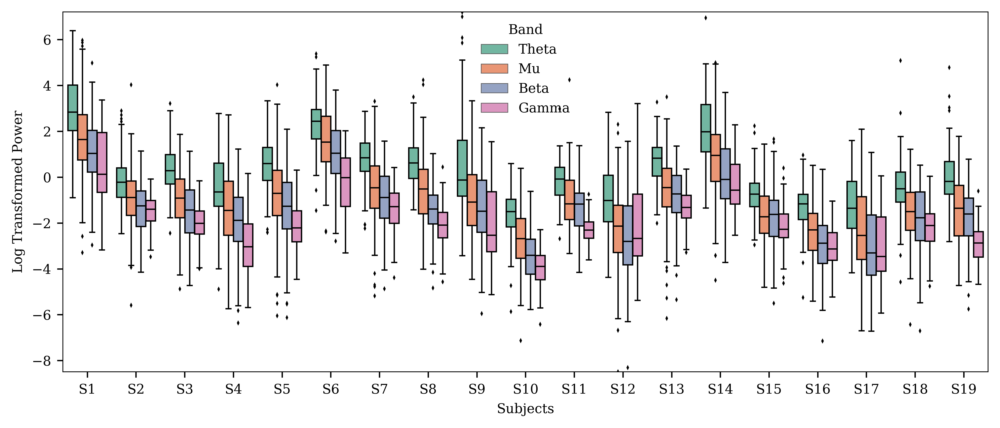

In [13]:
def get_colors():
    return np.array([
        [0.1, 0.1, 0.1],          # black
        [0.4, 0.4, 0.4],          # very dark gray
        [0.7, 0.7, 0.7],          # dark gray
        [0.9, 0.9, 0.9],          # light gray
        [0.984375, 0.7265625, 0], # dark yellow
        [1, 1, 0.9]               # light yellow
    ])
    
df_long = df
df_long['sub2'] = df_long['sub'].replace(sub_keys)
df_long = pd.melt(df_long, id_vars='sub2', value_vars=['theta_power_log', 'mu_power_log', 'beta_power_log', 'gamma_power_log'], var_name='Band', value_name='power')
df_long['Band'] = df_long['Band'].replace({'theta_power_log': 'Theta', 'mu_power_log': 'Mu', 'beta_power_log': 'Beta', 'gamma_power_log': 'Gamma'})

with plt.style.context(['science-raquib-axis']):
    fig, ax = plt.subplots(figsize=(10, 4))
    sns.boxplot(y="power", x="sub2", hue="Band", data=df_long, orient='v', fliersize=0.6, ax=ax, palette='Set2')
    plt.xlabel('Subjects')
    plt.ylabel('Log Transformed Power')
    for i, artist in enumerate(ax.artists):
        # col = artist.get_facecolor()
        artist.set_edgecolor('black')
        for j in range(i*6,i*6+6):
            line = ax.lines[j]
            line.set_color('black')
            line.set_mfc('black')
            line.set_mec('black')
# sns.despine(offset=10, trim=True)

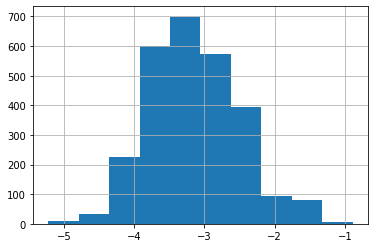

In [14]:
df['mep_duration_log'].hist()

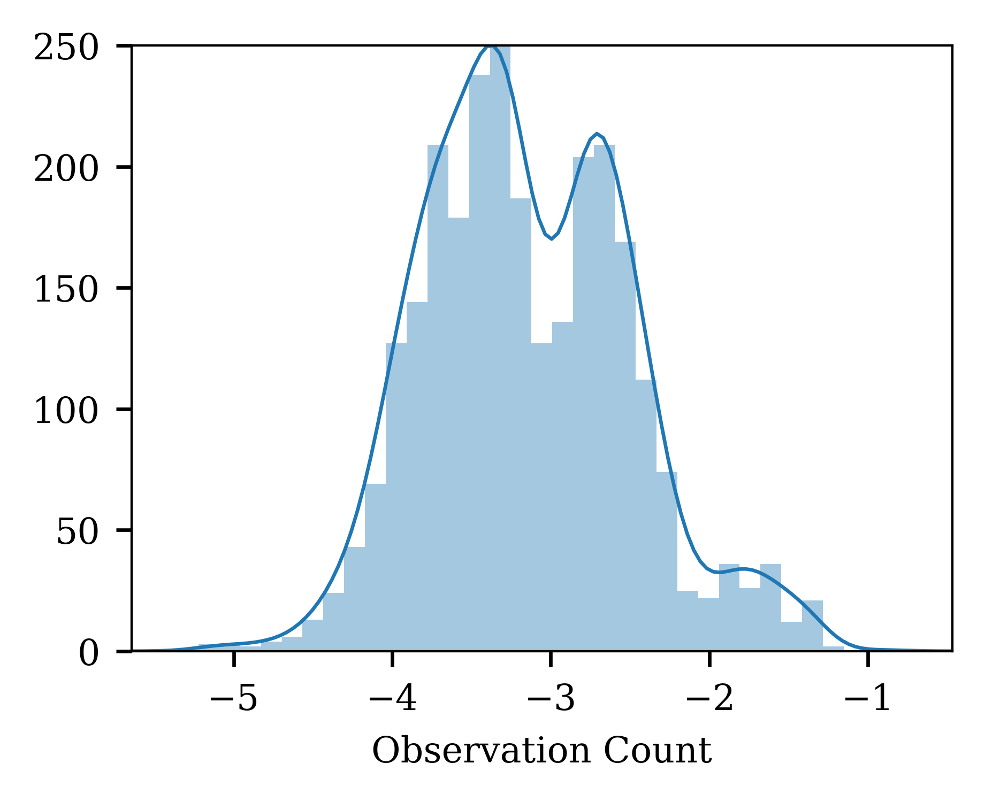

In [113]:
with plt.style.context(['science-raquib-axis']):
    # Plotting hist without kde
    ax = sns.distplot(df['mep_duration_log'], kde=False)

    # Creating another Y axis
    second_ax = ax.twinx()

    #Plotting kde without hist on the second Y axis
    sns.distplot(df['mep_duration_log'], ax=second_ax, kde=True, hist=False)

    #Removing Y ticks from the second axis
    second_ax.set_yticks([])
    ax.set_xlabel('Log Transformed MEP Duration')
    ax.set_xlabel('Observation Count')

In [15]:
sub_dummy = ['sub01', 'sub02', 'sub03', 'sub04', 'sub05', 'sub06', 'sub07', 'sub08', 'sub09', 'sub10', 'sub11', 'sub12', 'sub13', 'sub14', 'sub15', 'sub16', 'sub17', 'sub18', 'sub19']
i = 0
df_mean = []
for sub in df['sub'].unique():
    df_mean.append({
        'sub': sub_dummy[i],
        'theta_mean': round(df[df['sub'] == sub]['theta_power_log'].mean(), 2),
        'theta_std': round(df[df['sub'] == sub]['theta_power_log'].std(), 2),
        'mu_mean': round(df[df['sub'] == sub]['mu_power_log'].mean(), 2),
        'mu_std': round(df[df['sub'] == sub]['mu_power_log'].std(), 2),
        'beta_mean': round(df[df['sub'] == sub]['beta_power_log'].mean(), 2),
        'beta_std': round(df[df['sub'] == sub]['beta_power_log'].std(), 2),
        'gamma_mean': round(df[df['sub'] == sub]['gamma_power_log'].mean(), 2),
        'gamma_std': round(df[df['sub'] == sub]['gamma_power_log'].std(), 2),
        'mep_size_log_mean': round(df[df['sub'] == sub]['mep_size_log'].mean(), 2),
        'mep_size_log_std': round(df[df['sub'] == sub]['mep_size_log'].std(), 2),
        'mep_latency_mean': round(df[df['sub'] == sub]['mep_latency'].mean(), 3),
        'mep_latency_std': round(df[df['sub'] == sub]['mep_latency'].std(), 3),
        'mep_duration_log_mean': round(df[df['sub'] == sub]['mep_duration_log'].mean(), 2),
        'mep_duration_log_std': round(df[df['sub'] == sub]['mep_duration_log'].std(), 2),
        'mep_area_log_mean': round(df[df['sub'] == sub]['mep_area_log'].mean(), 2),
        'mep_area_log_std': round(df[df['sub'] == sub]['mep_area_log'].std(), 2),
    })
    i = i+1
df_mean = pd.DataFrame(df_mean)
df_mean[['sub', 'theta_mean', 'theta_std', 'mu_mean', 'mu_std', 'beta_mean', 'beta_std', 'gamma_mean', 'gamma_std', 'mep_size_log_mean', 'mep_size_log_std', 'mep_latency_mean', 'mep_latency_std', 'mep_duration_log_mean', 'mep_duration_log_std', 'mep_area_log_mean', 'mep_area_log_std']]

,sub,theta_mean,theta_std,mu_mean,mu_std,beta_mean,beta_std,gamma_mean,gamma_std,mep_size_log_mean,mep_size_log_std,mep_latency_mean,mep_latency_std,mep_duration_log_mean,mep_duration_log_std,mep_area_log_mean,mep_area_log_std
0,sub01,2.98,1.41,1.66,1.72,1.10,1.46,0.48,1.53,-0.02,0.88,0.022,0.001,-2.26,0.70,-5.22,0.89
1,sub02,-0.24,1.08,-0.91,1.28,-1.34,1.12,-1.48,0.68,-0.70,0.62,0.021,0.001,-3.28,0.47,-6.39,0.76
2,sub03,0.36,0.95,-0.94,1.27,-1.53,1.21,-1.97,0.80,-1.55,0.92,0.025,0.001,-3.76,0.47,-7.35,1.09
3,sub04,-0.39,1.35,-1.46,1.61,-1.89,1.43,-2.98,1.21,-2.25,1.00,0.020,0.002,-3.26,0.54,-7.23,0.79
4,sub05,0.57,1.11,-0.72,1.75,-1.31,1.49,-2.12,1.03,-0.26,0.86,0.022,0.001,-3.10,0.42,-5.68,0.79
5,sub06,2.32,1.05,1.57,1.46,1.02,1.36,-0.20,1.29,-1.49,0.71,0.025,0.002,-3.29,0.55,-6.88,0.75
6,sub07,0.81,1.04,-0.50,1.52,-0.94,1.22,-1.39,0.90,-1.17,0.66,0.025,0.001,-3.44,0.37,-6.72,0.62
7,sub08,0.62,0.97,-0.62,1.42,-1.48,1.06,-2.11,0.87,0.58,0.87,0.023,0.001,-2.49,0.72,-4.81,0.89
8,sub09,0.42,2.01,-0.99,1.62,-1.27,1.66,-2.11,1.50,-0.34,1.41,0.025,0.001,-3.09,0.68,-5.94,1.52
9,sub10,-1.55,0.96,-2.68,1.35,-3.46,1.04,-3.97,0.72,-1.78,0.97,0.028,0.002,-2.87,0.52,-7.06,0.97


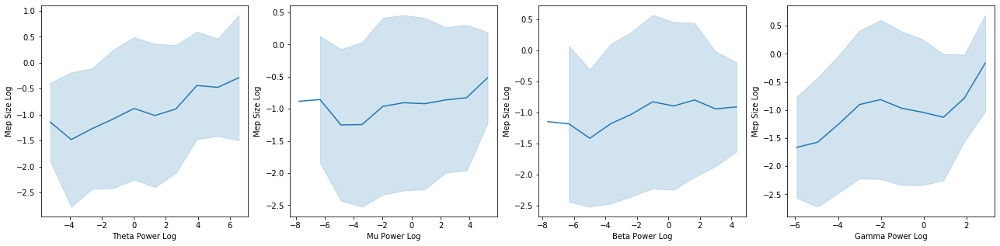

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

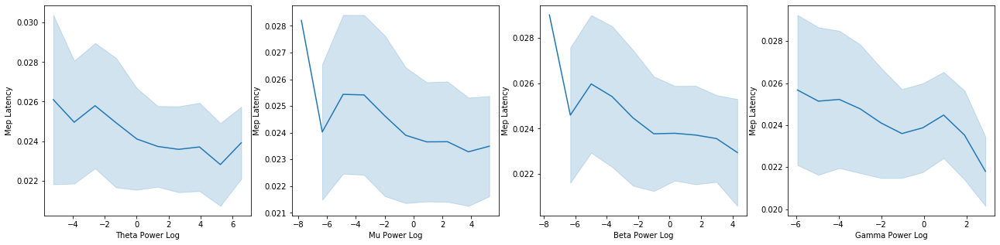

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

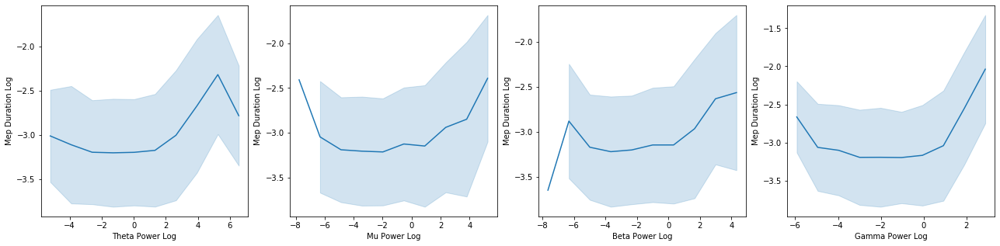

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

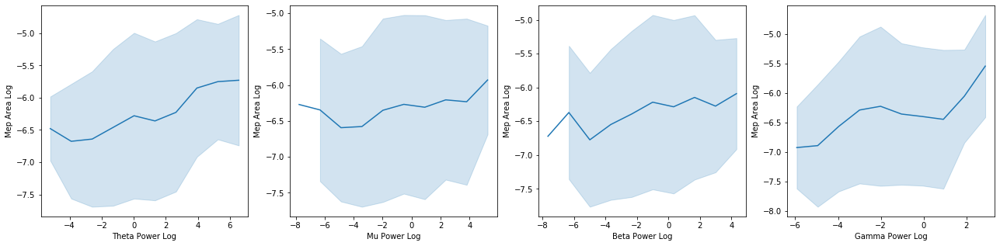

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

In [16]:
def plot_line(x, y, ax):
    plt.figure()
#     for sub in df['sub'].unique()[0:1]:
#         df2 = df[df['sub'] == sub]
    df2 = df
    x_segments = 10
    bins = np.linspace(df2[x].min(), df2[x].max(), x_segments+1)
    labels = np.linspace((bins[0] + bins[1])/2, (bins[-2] + bins[-1])/2, x_segments)
    df2[x + '_bin'] = pd.cut(df2[x], bins=bins, labels=labels)
    sns.lineplot(x=x + "_bin", y=y, data=df2, ci='sd', ax=ax)
    xlabel = ' '.join(x.split('_')).title()
    ylabel = ' '.join(y.split('_')).title()
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    
def plot_response_line(response):
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(22,5))
    plot_line('theta_power_log', response, ax=ax1)
    plot_line('mu_power_log', response, ax=ax2)
    plot_line('beta_power_log', response, ax=ax3)
    plot_line('gamma_power_log', response, ax=ax4)

plot_response_line('mep_size_log')
plot_response_line('mep_latency')
plot_response_line('mep_duration_log')
plot_response_line('mep_area_log')

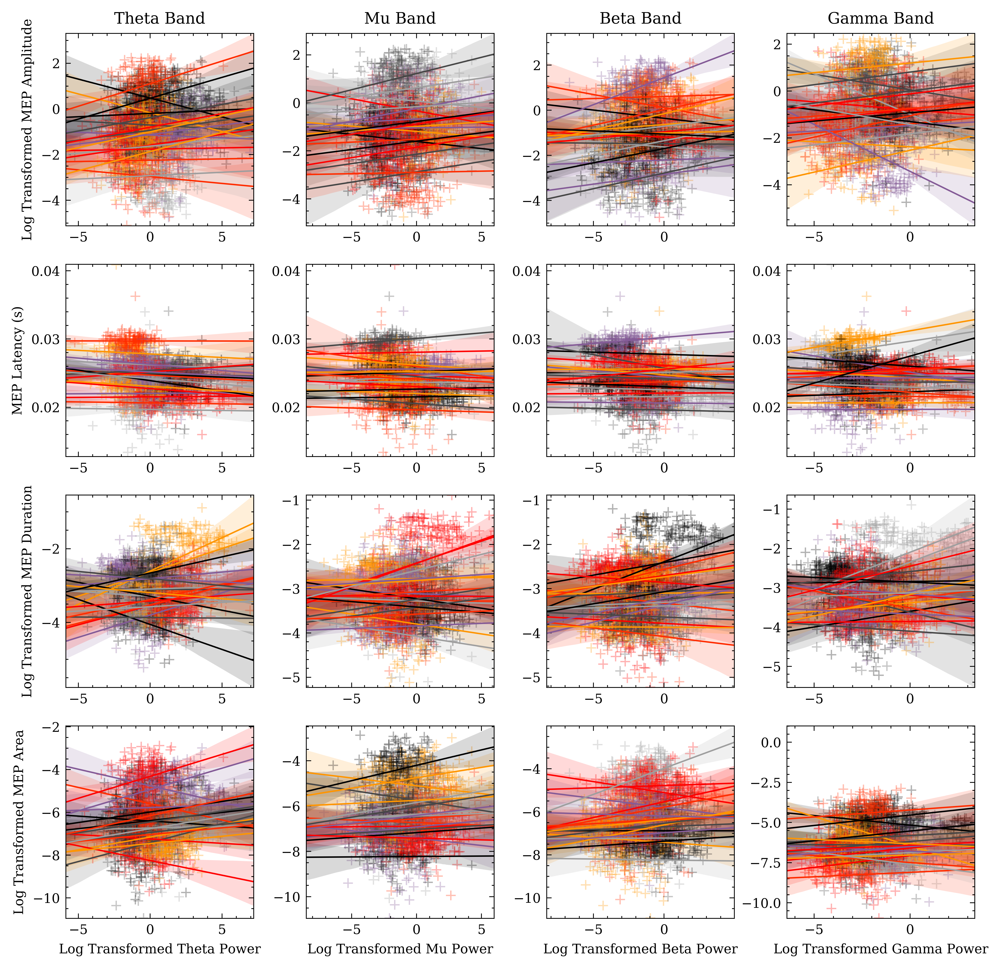

In [22]:
linewidth = 0.9
scatter = True
with plt.style.context(['science-raquib']):
    fig, axs = plt.subplots(4, 4, figsize=(10,10))
    
    i = 0
    for band in ['theta', 'mu', 'beta', 'gamma']:
        for j in range(4):
            axs[j, i].set_xlim([df[band + '_power_log'].min(), df[band + '_power_log'].max()])
        i = i + 1
    i = 0
#     for target in ['mep_size_log', 'mep_latency', 'mep_area_log']:
#         for j in range(4):
#             axs[i, j].set_ylim([df[target].min(), df[target].max()])
#         i = i + 1
    
    
    i = 0
    for band in ['theta', 'mu', 'beta', 'gamma']:
        for sub in df['sub'].unique():
            df_sub = df[df['sub'] == sub]
            sns.regplot(x=band + "_power_log", y="mep_size_log", data=df_sub, ax=axs[0,i], scatter=scatter, scatter_kws={'alpha': 0.3}, marker='+', truncate=False, line_kws={'linewidth': linewidth})
            sns.regplot(x=band + "_power_log", y="mep_latency", data=df_sub, ax=axs[1,i], scatter=scatter, scatter_kws={'alpha': 0.3}, marker='+', truncate=False, line_kws={'linewidth': linewidth})
            sns.regplot(x=band + "_power_log", y="mep_duration_log", data=df_sub, ax=axs[2,i], scatter=scatter, scatter_kws={'alpha': 0.3}, marker='+', truncate=False, line_kws={'linewidth': linewidth})
            sns.regplot(x=band + "_power_log", y="mep_area_log", data=df_sub, ax=axs[3,i], scatter=scatter, scatter_kws={'alpha': 0.3}, marker='+', truncate=False, line_kws={'linewidth': linewidth})
        i = i+1

    axs[0,0].set_ylabel('Log Transformed MEP Amplitude')
    axs[1,0].set_ylabel('MEP Latency (s)')
    axs[2,0].set_ylabel('Log Transformed MEP Duration')
    axs[3,0].set_ylabel('Log Transformed MEP Area')
    axs[3, 0].set_xlabel('Log Transformed Theta Power')
    axs[3, 1].set_xlabel('Log Transformed Mu Power')
    axs[3, 2].set_xlabel('Log Transformed Beta Power')
    axs[3, 3].set_xlabel('Log Transformed Gamma Power')
    axs[0,0].set_title('Theta Band')
    axs[0,1].set_title('Mu Band')
    axs[0,2].set_title('Beta Band')
    axs[0,3].set_title('Gamma Band')

    for i in range(4):
        for j in range(3):
            axs[i, j+1].set_ylabel('')

    for i in [0, 1, 2]:
        for j in range(4):
            axs[i, j].set_xlabel('')
    
    fig.subplots_adjust(wspace=0.28)

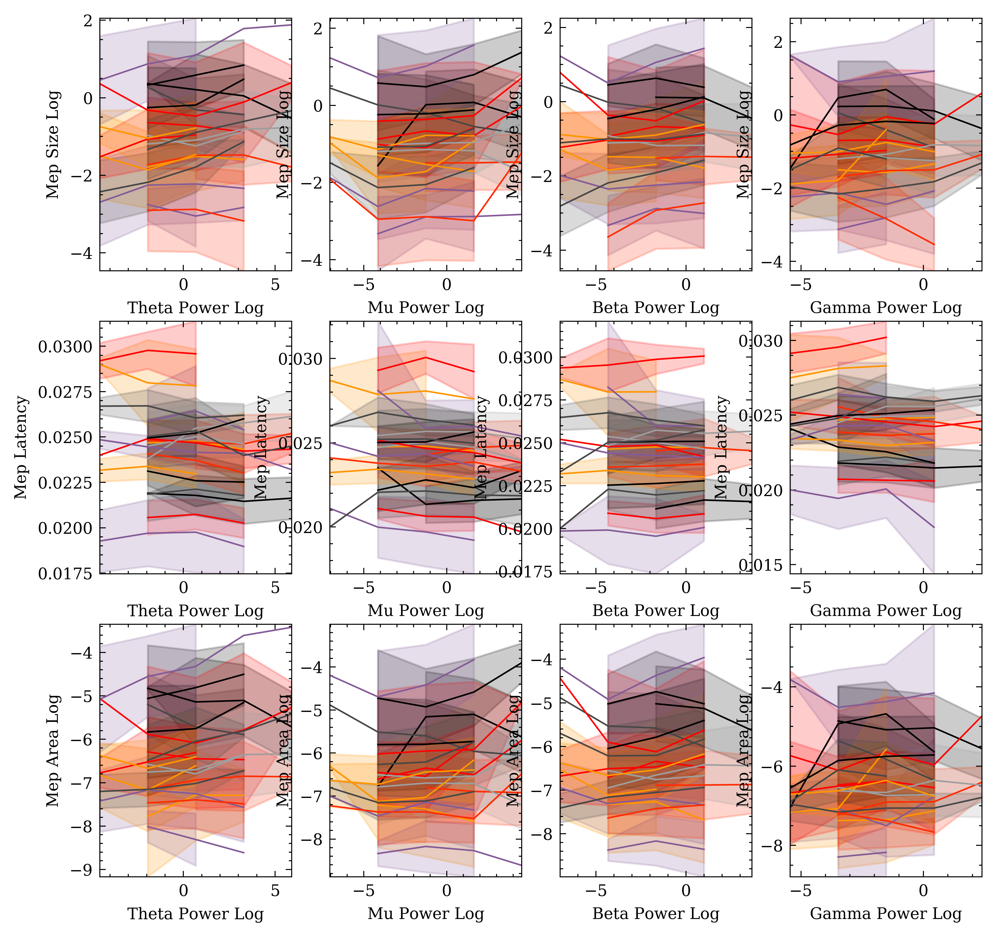

In [174]:
# def plot_line(x, y, ax):
#     plt.figure()
# #     for sub in df['sub'].unique()[0:1]:
# #         df2 = df[df['sub'] == sub]
#     df2 = df
#     x_segments = 10
#     bins = np.linspace(df2[x].min(), df2[x].max(), x_segments+1)
#     labels = np.linspace((bins[0] + bins[1])/2, (bins[-2] + bins[-1])/2, x_segments)
#     df2[x + '_bin'] = pd.cut(df2[x], bins=bins, labels=labels)
#     sns.lineplot(x=x + "_bin", y=y, data=df2, ci='sd', ax=ax)
#     xlabel = ' '.join(x.split('_')).title()
#     ylabel = ' '.join(y.split('_')).title()
#     ax.set_xlabel(xlabel)
#     ax.set_ylabel(ylabel)
    
# def plot_response_line(response):
#     fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(22,5))
#     plot_line('theta_power_log', response, ax=ax1)
#     plot_line('mu_power_log', response, ax=ax2)
#     plot_line('beta_power_log', response, ax=ax3)
#     plot_line('gamma_power_log', response, ax=ax4)

# plot_response_line('mep_size_log')
# plot_response_line('mep_latency')
# plot_response_line('mep_duration_log')
# plot_response_line('mep_area_log')


x_segments = 5
i = 0

with plt.style.context(['science-raquib']):
    fig, axs = plt.subplots(3, 4, figsize=(8, 8))
    for y in ['mep_size_log', 'mep_latency', 'mep_area_log']:
        j = 0
        for x in ['theta_power_log', 'mu_power_log', 'beta_power_log', 'gamma_power_log']:
            df2 = df
            bins = np.linspace(df2[x].min(), df2[x].max(), x_segments+1)
            labels = np.linspace((bins[0] + bins[1])/2, (bins[-2] + bins[-1])/2, x_segments)
            df2[x + '_bin'] = pd.cut(df2[x], bins=bins, labels=labels)
            for sub in df2['sub'].unique():
                df3 = df2[df2['sub'] == sub]
                sns.lineplot(x=x + "_bin", y=y, data=df3, ci='sd', ax=axs[i, j])
            xlabel = ' '.join(x.split('_')).title()
            ylabel = ' '.join(y.split('_')).title()
            axs[i, j].set_xlabel(xlabel)
            axs[i, j].set_ylabel(ylabel)
            j = j + 1
        i = i + 1